In [41]:
import json
import cv2
import numpy as np
from yolo.frontend import create_yolo
from yolo.backend.utils.annotation import parse_annotation
from yolo.backend.utils.eval.fscore import count_true_positives, calc_score
from yolo.backend.utils.box import draw_scaled_boxes, nms_boxes
import os
import yolo
%matplotlib inline
from matplotlib import pyplot as plt
import glob
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '3'
import tensorflow as tf
tf.logging.set_verbosity(tf.logging.ERROR)
fig=plt.figure(figsize=(18, 16), dpi= 80, facecolor='w', edgecolor='k')
plt.rcParams['figure.figsize'] = [10, 10]

<Figure size 1440x1280 with 0 Axes>

In [32]:
# 1. extract arguments
conf = "config_colab_jersey.json" 
weights = "weights_colab_jersey.h5"
threshold = 0.3


with open(conf) as config_buffer:
    config = json.loads(config_buffer.read())



In [38]:
# 2. create yolo instance & predict
detector = create_yolo(config['model']['architecture'],
                   config['model']['labels'],
                   config['model']['input_size'],
                   config['model']['anchors'])
detector.load_weights(weights)



__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_5 (InputLayer)            (None, 416, 416, 3)  0                                            
__________________________________________________________________________________________________
conv1 (Conv2D)                  (None, 208, 208, 64) 9472        input_5[0][0]                    
__________________________________________________________________________________________________
bn_conv1 (BatchNormalization)   (None, 208, 208, 64) 256         conv1[0][0]                      
__________________________________________________________________________________________________
activation_197 (Activation)     (None, 208, 208, 64) 0           bn_conv1[0][0]                   
__________________________________________________________________________________________________
max_poolin

Loading pre-trained weights in weights_colab_jersey.h5


In [14]:
import shutil
shutil.rmtree("detected_full_image/")

4-boxes are detected.


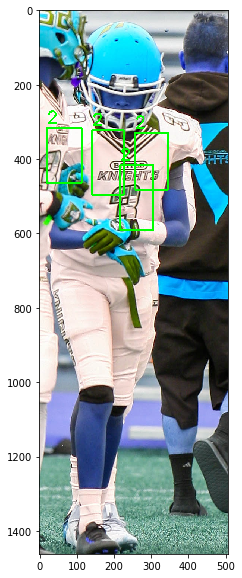

2222
2-boxes are detected.


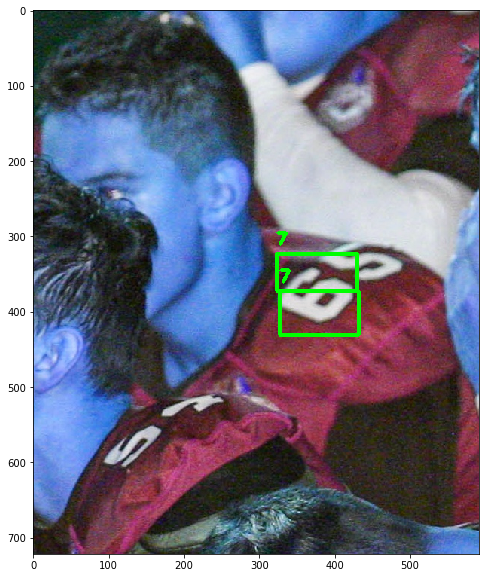

77
3-boxes are detected.


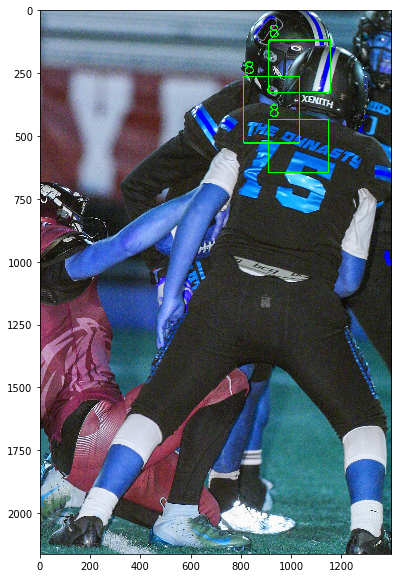

888
1-boxes are detected.


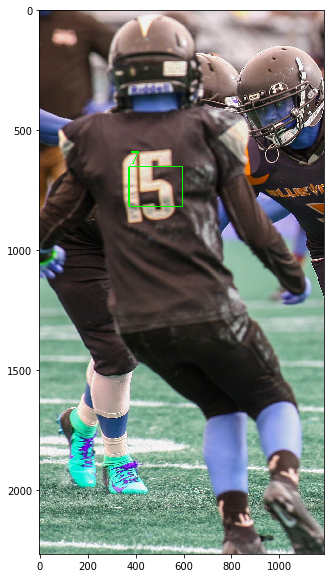

7
0-boxes are detected.


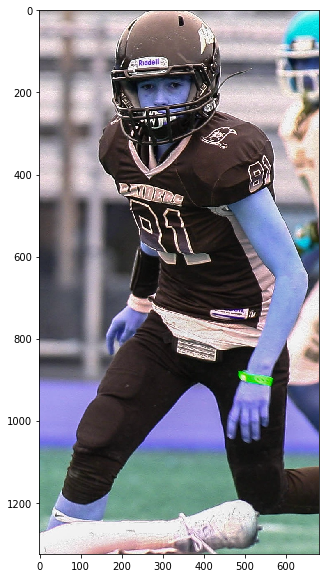


3-boxes are detected.


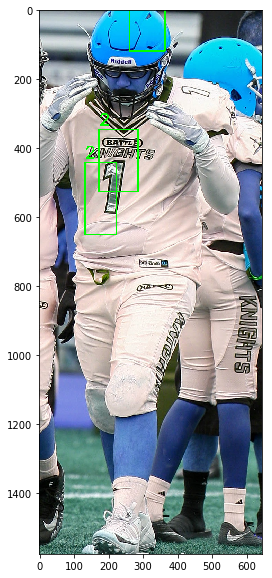

722
2-boxes are detected.


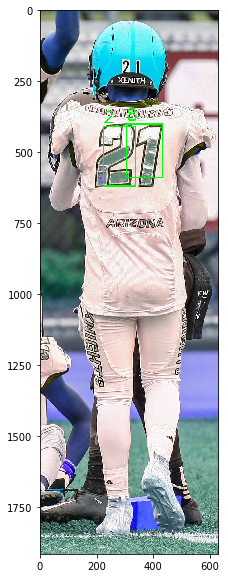

28
0-boxes are detected.


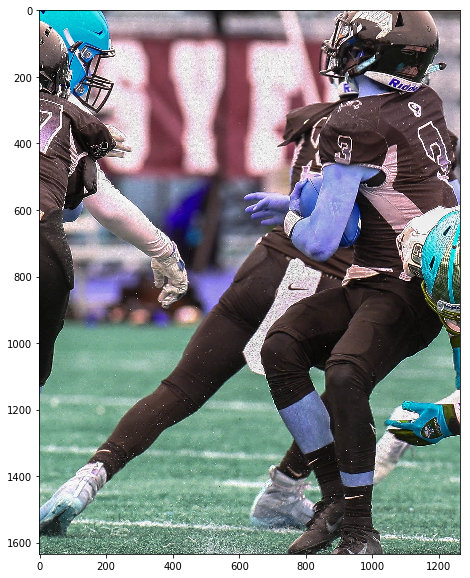


5-boxes are detected.


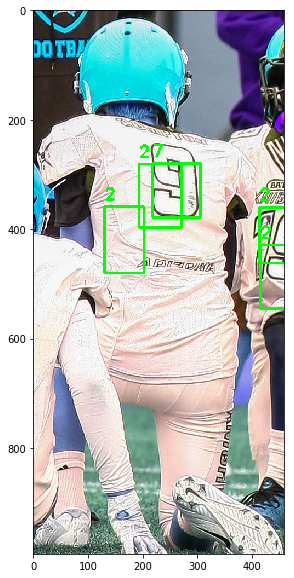

27222
1-boxes are detected.


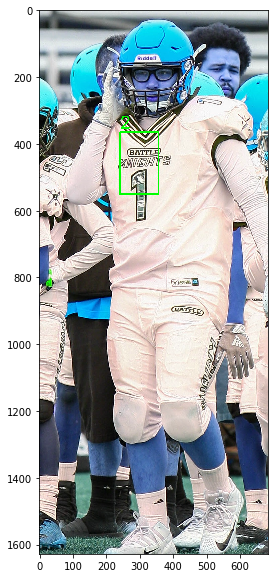

2
1-boxes are detected.


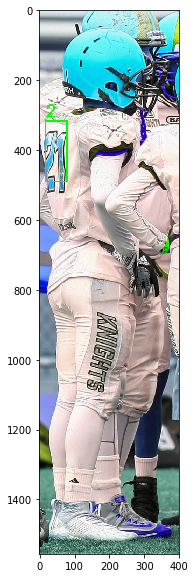

2
0-boxes are detected.


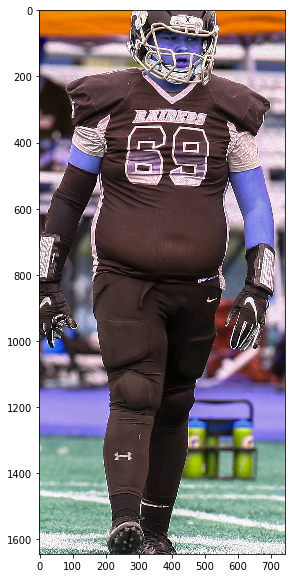


0-boxes are detected.


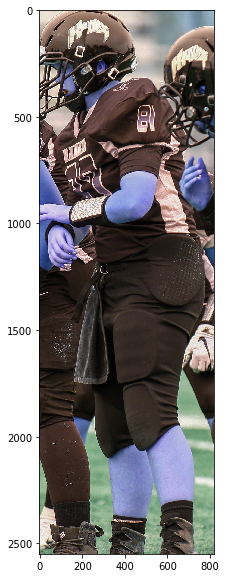


0-boxes are detected.


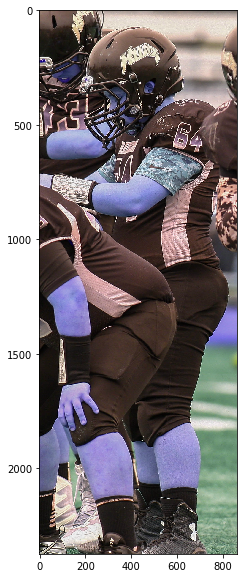


0-boxes are detected.


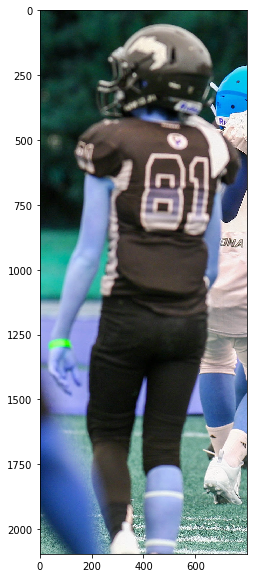


4-boxes are detected.


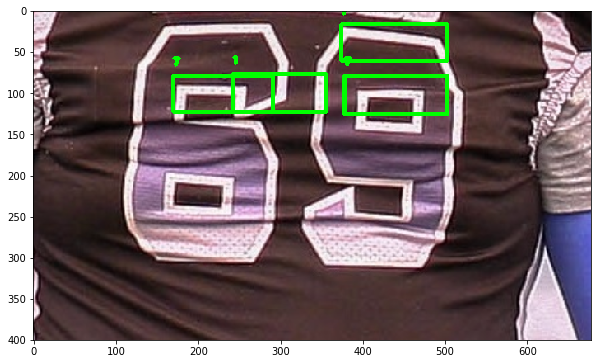

7717
0-boxes are detected.


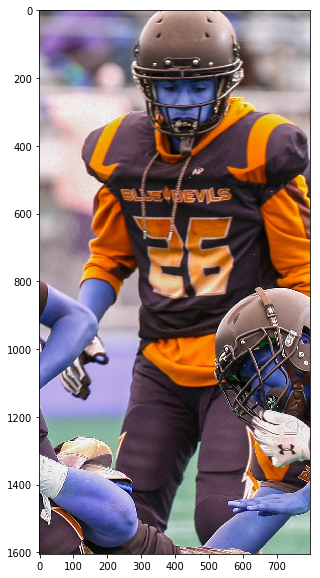


1-boxes are detected.


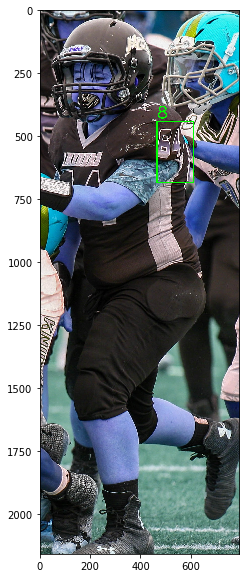

8
1-boxes are detected.


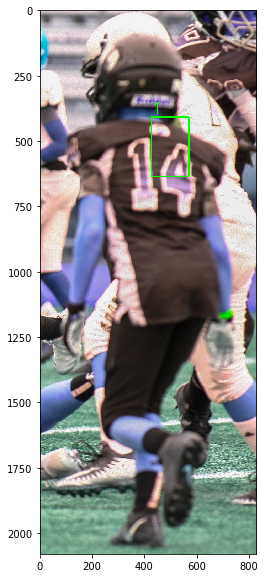

1
1-boxes are detected.


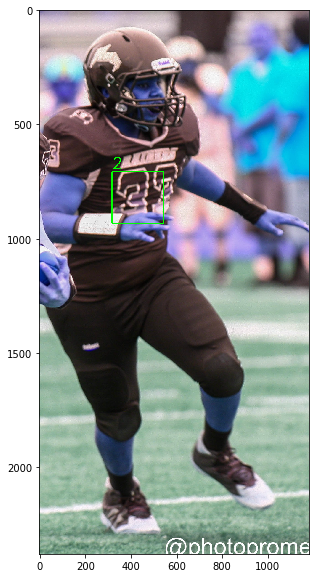

2
1-boxes are detected.


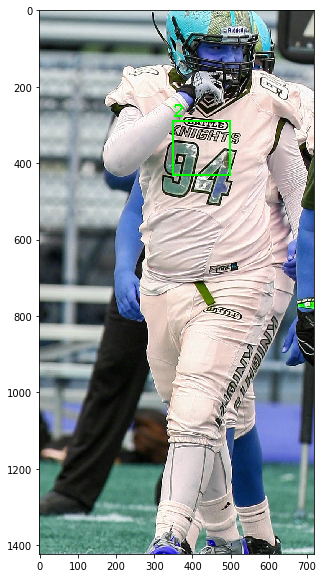

2
2-boxes are detected.


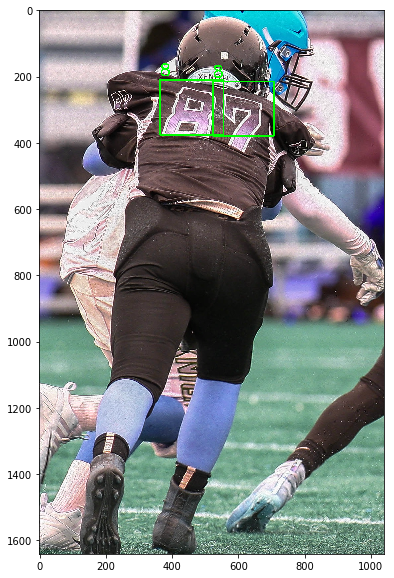

88
2-boxes are detected.


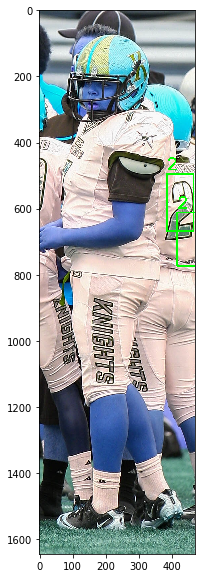

22
0-boxes are detected.


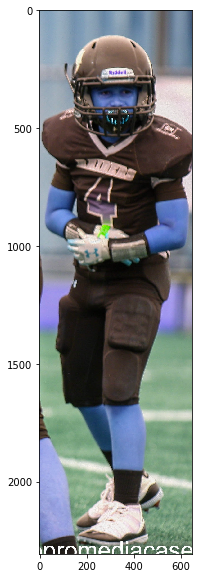


2-boxes are detected.


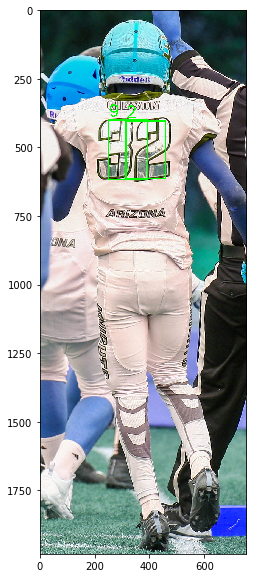

92
4-boxes are detected.


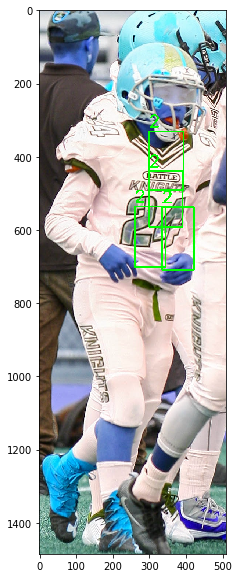

2222
2-boxes are detected.


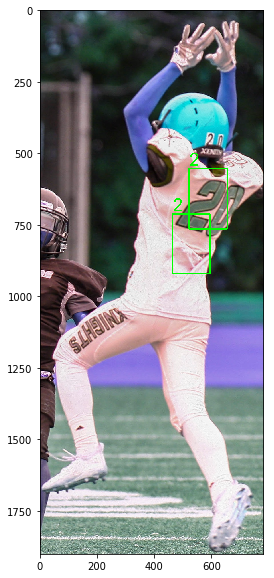

22
2-boxes are detected.


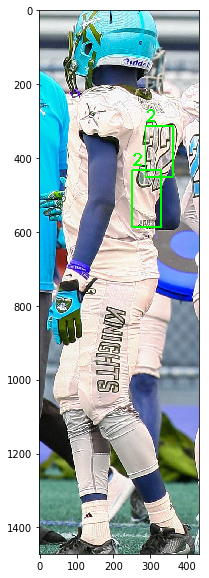

22
1-boxes are detected.


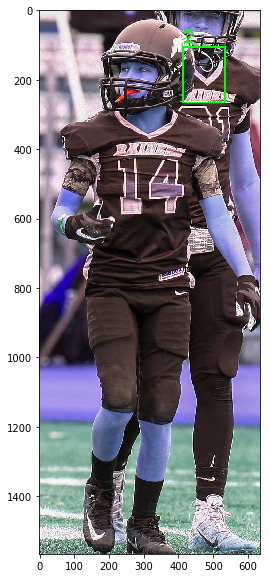

2
0-boxes are detected.


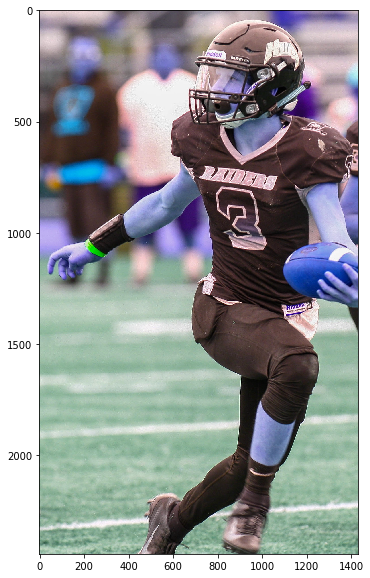


2-boxes are detected.


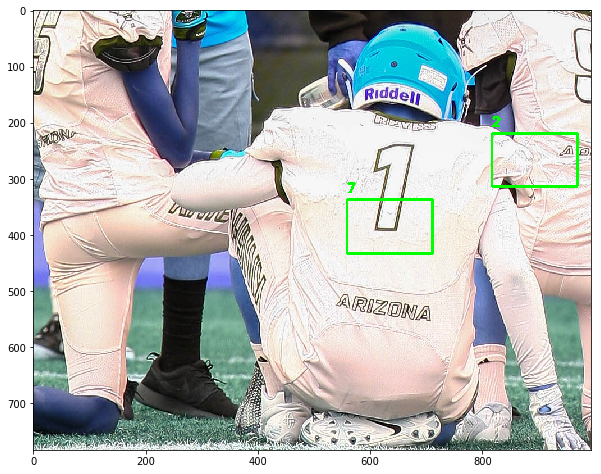

27
1-boxes are detected.


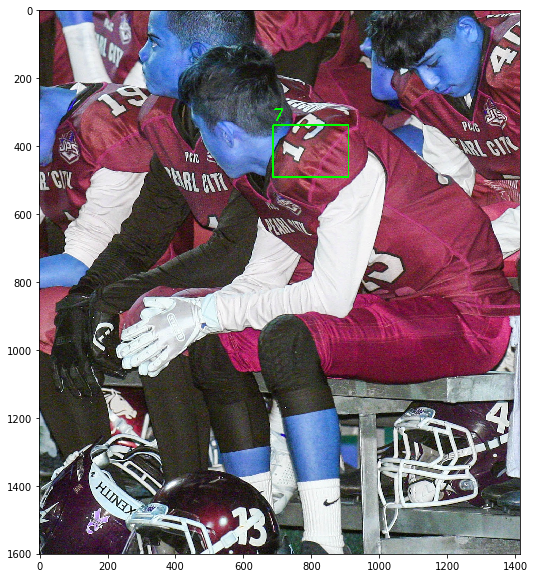

7
1-boxes are detected.


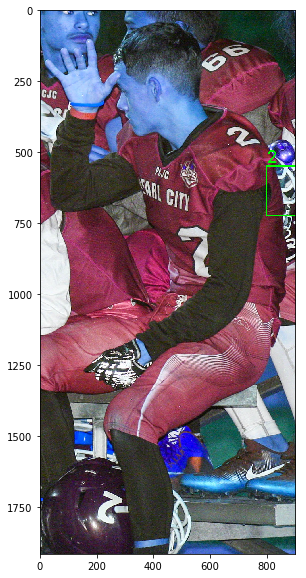

2
8-boxes are detected.


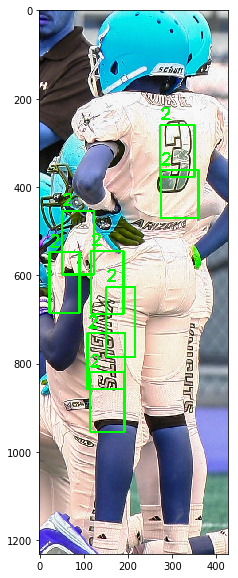

22222222
2-boxes are detected.


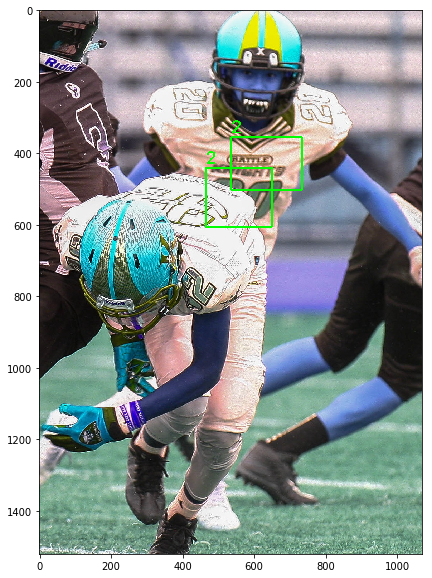

22
4-boxes are detected.


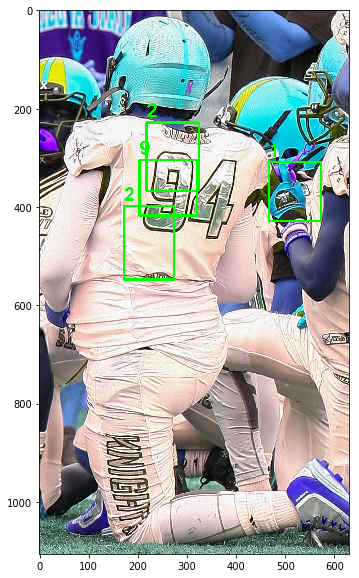

2912
0-boxes are detected.


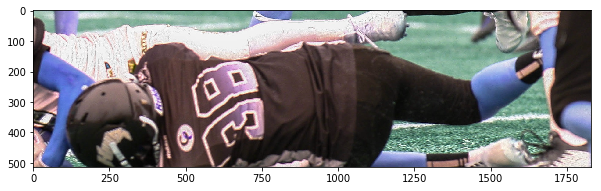


2-boxes are detected.


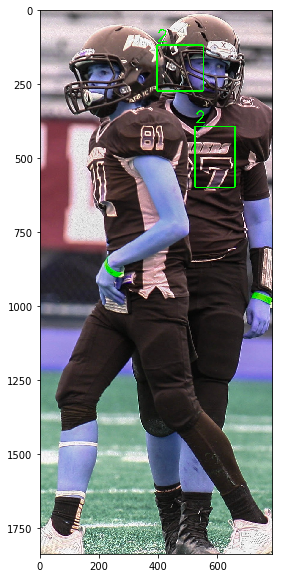

22
6-boxes are detected.


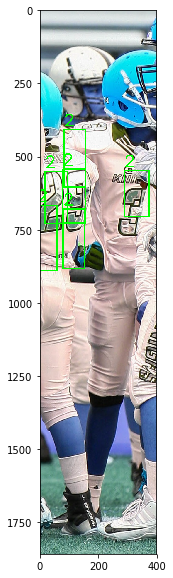

222222
5-boxes are detected.


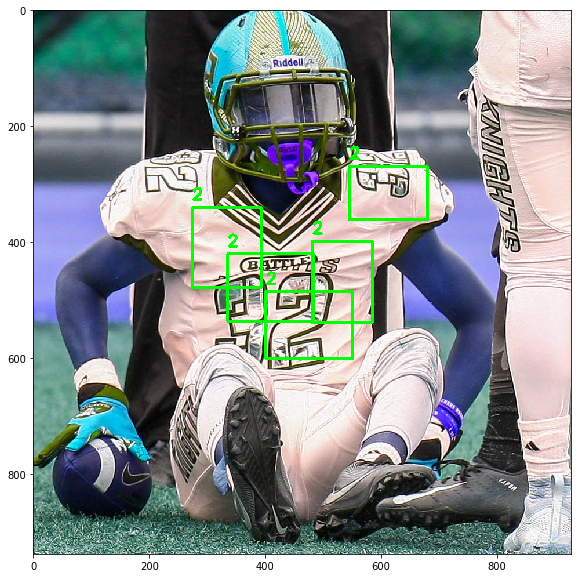

22222
3-boxes are detected.


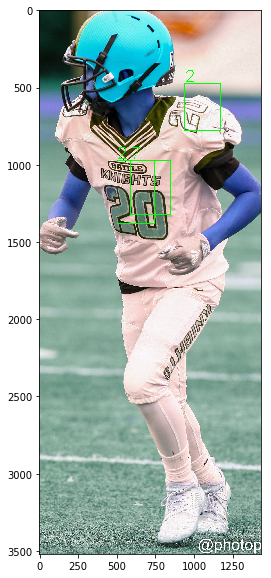

227
2-boxes are detected.


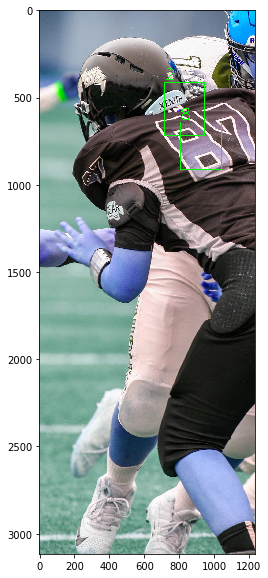

28
4-boxes are detected.


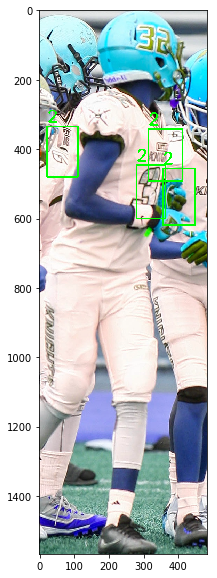

2222
0-boxes are detected.


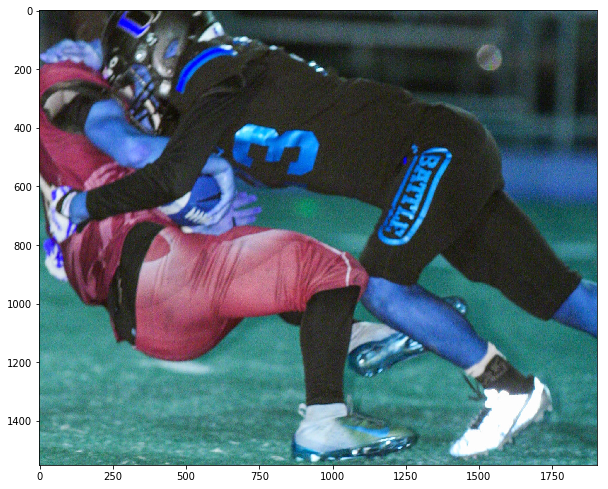


0-boxes are detected.


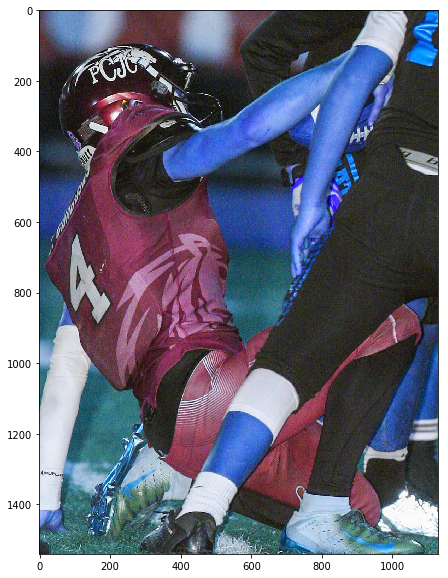


1-boxes are detected.


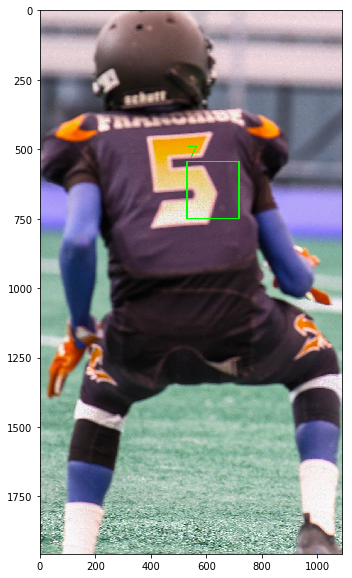

7
1-boxes are detected.


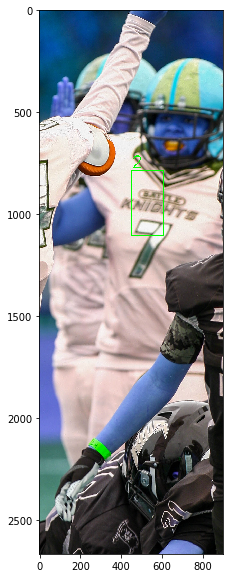

2
1-boxes are detected.


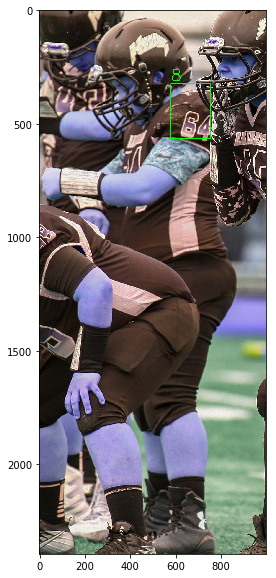

8
2-boxes are detected.


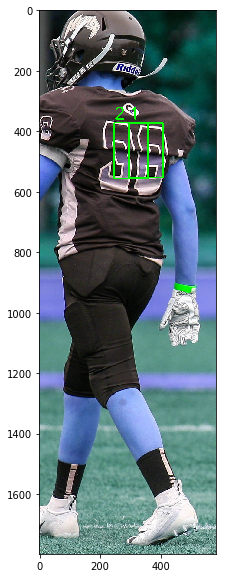

21
1-boxes are detected.


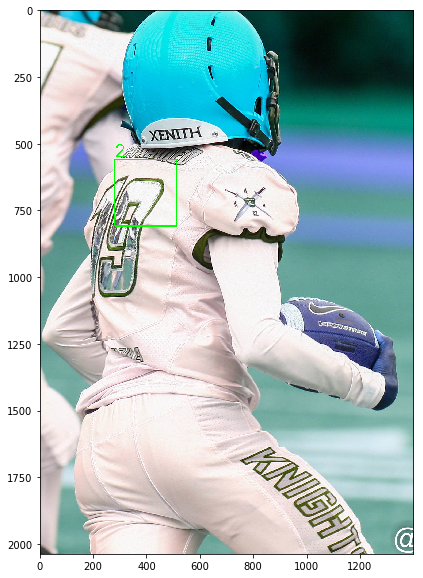

2
0-boxes are detected.


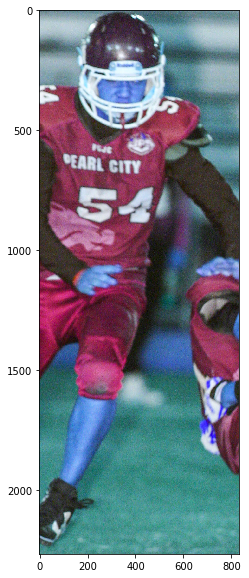


1-boxes are detected.


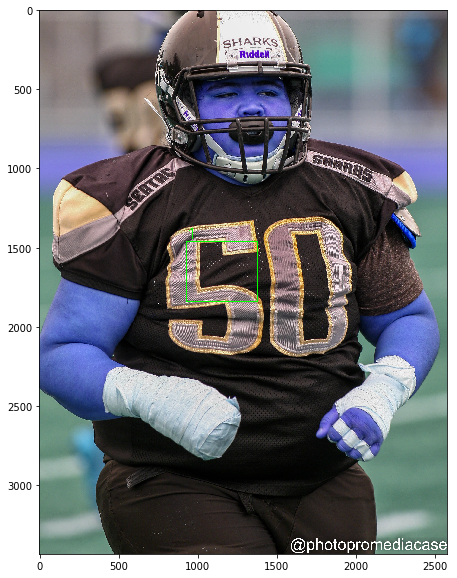

1
0-boxes are detected.


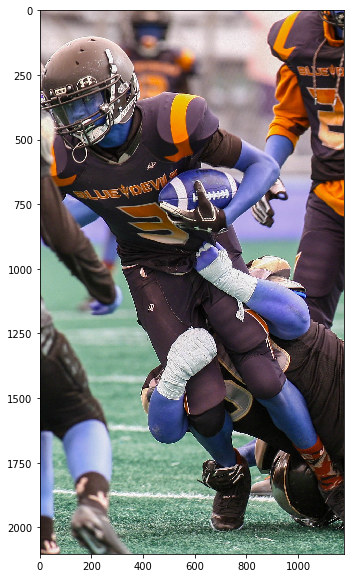


0-boxes are detected.


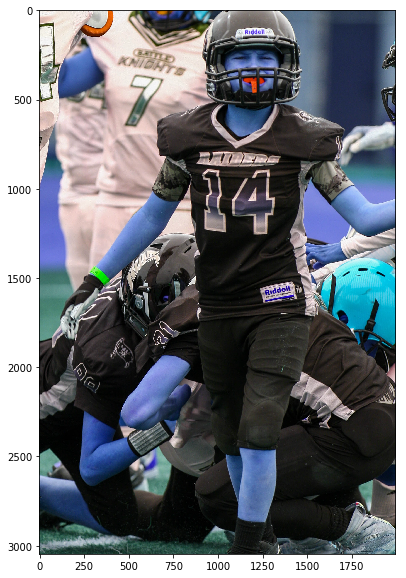


2-boxes are detected.


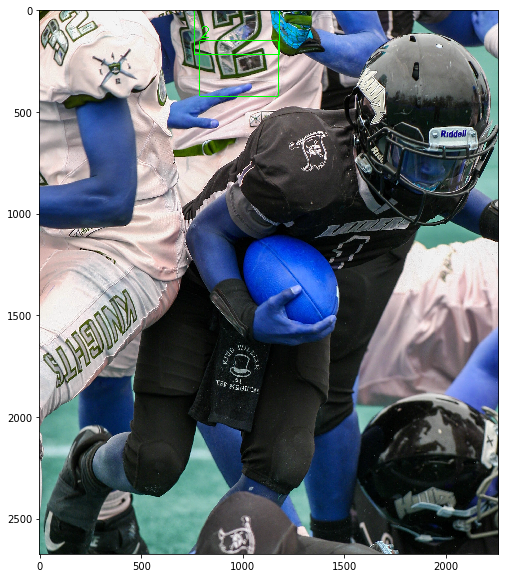

22
0-boxes are detected.


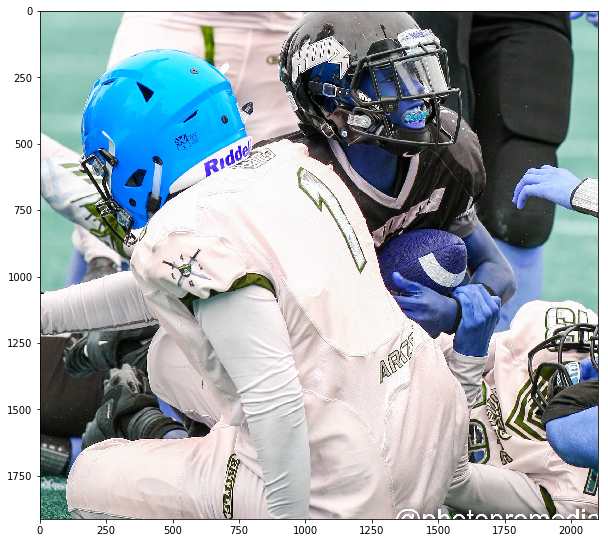


1-boxes are detected.


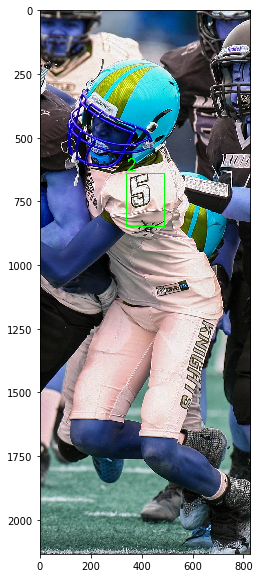

2
0-boxes are detected.


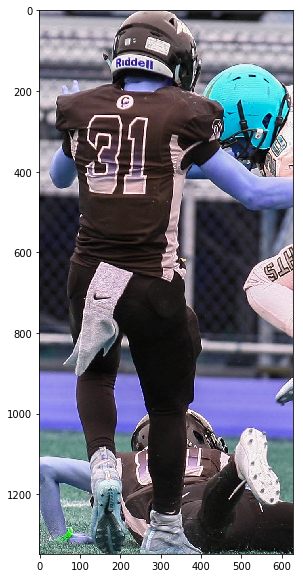


1-boxes are detected.


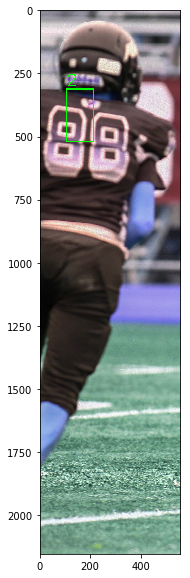

2
5-boxes are detected.


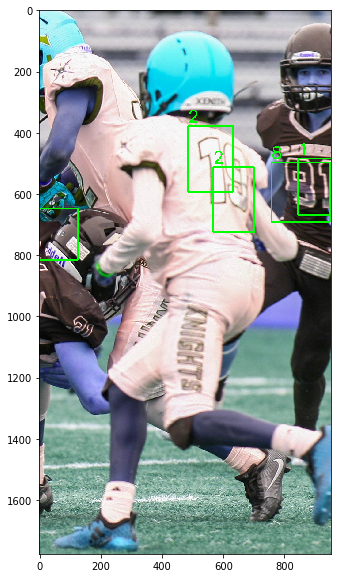

22818
0-boxes are detected.


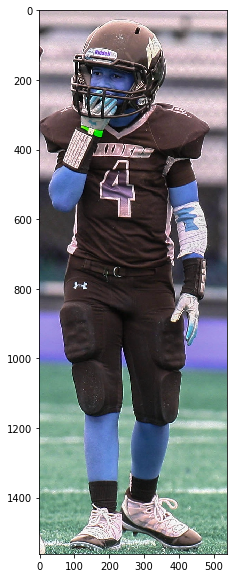


0-boxes are detected.


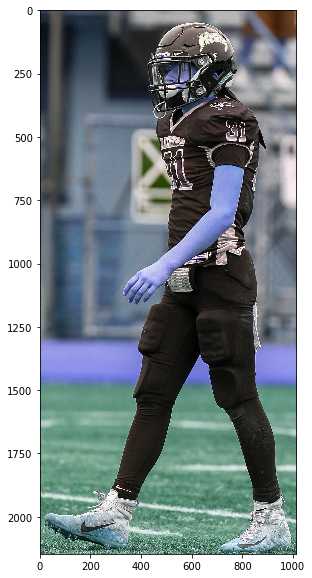


6-boxes are detected.


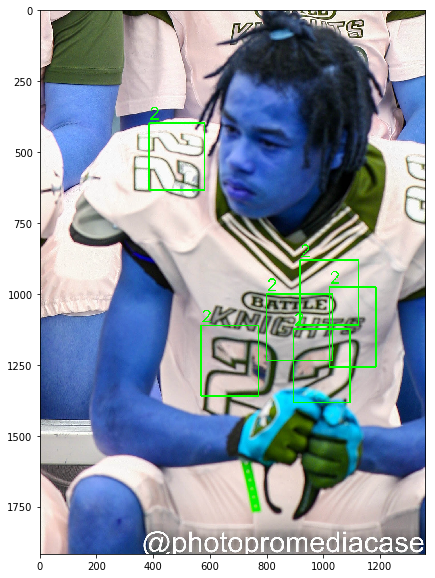

222222
3-boxes are detected.


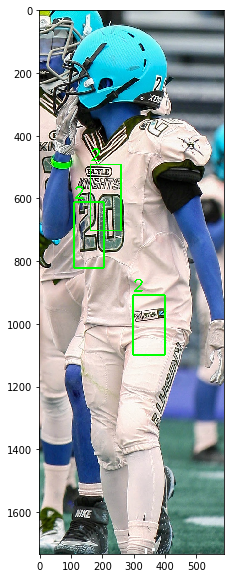

222
6-boxes are detected.


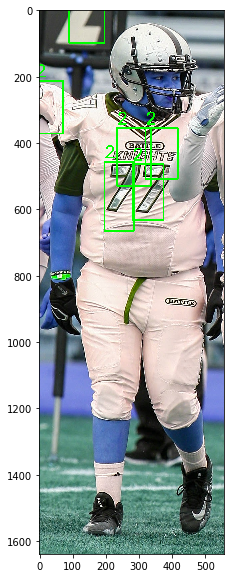

722222
0-boxes are detected.


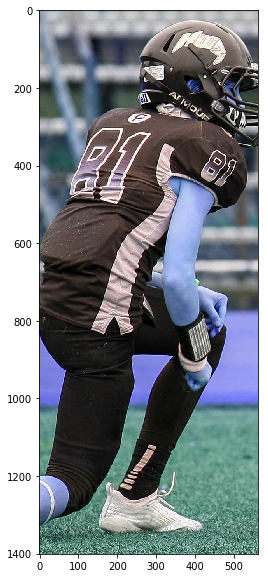


4-boxes are detected.


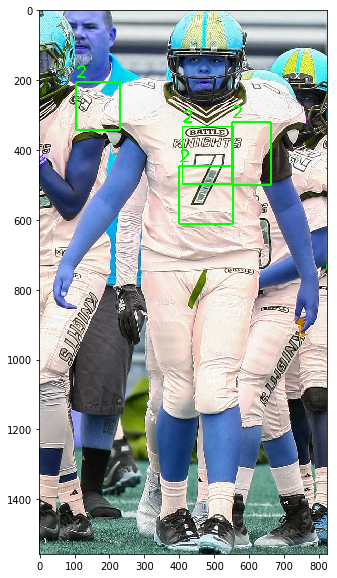

2222
2-boxes are detected.


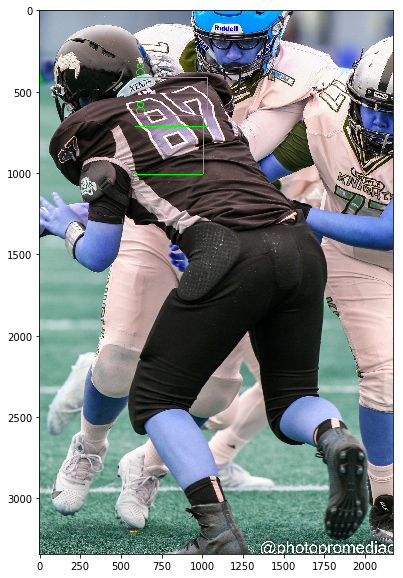

88
5-boxes are detected.


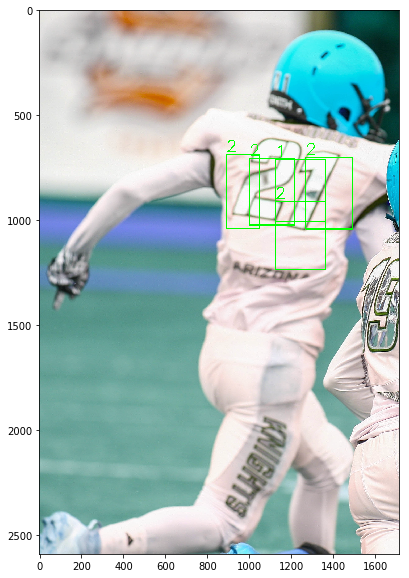

22122
3-boxes are detected.


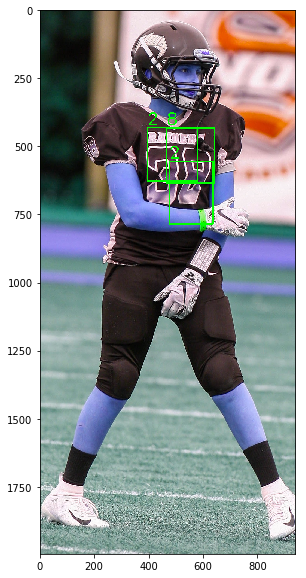

282
0-boxes are detected.


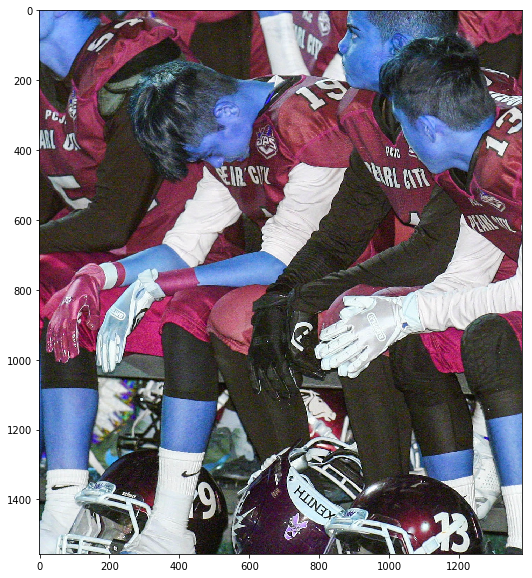


1-boxes are detected.


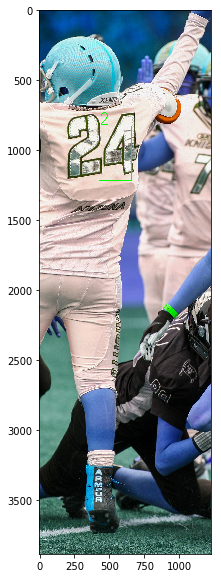

2
2-boxes are detected.


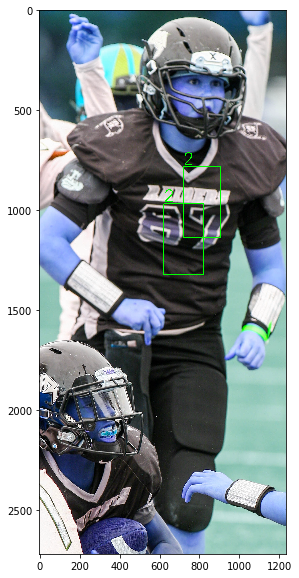

22
1-boxes are detected.


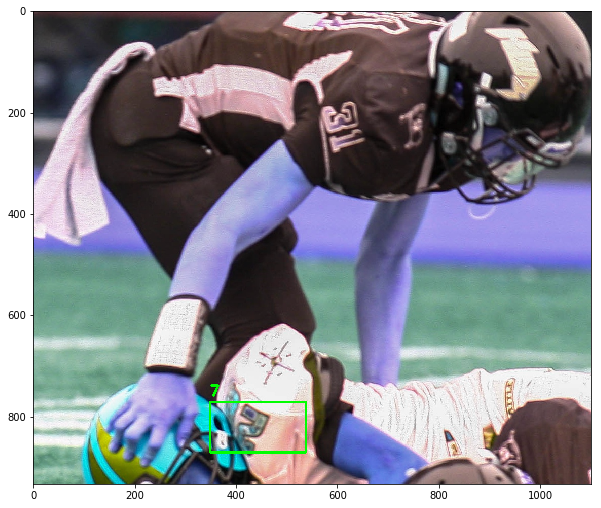

7
0-boxes are detected.


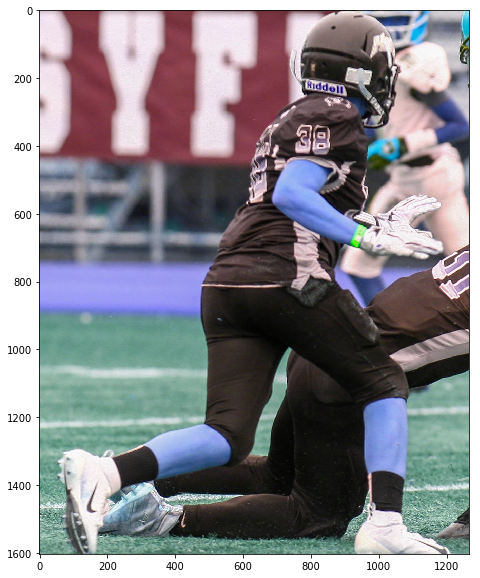


0-boxes are detected.


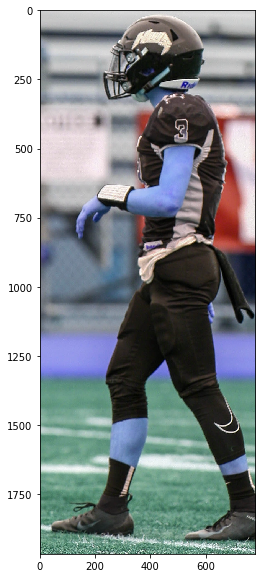


7-boxes are detected.


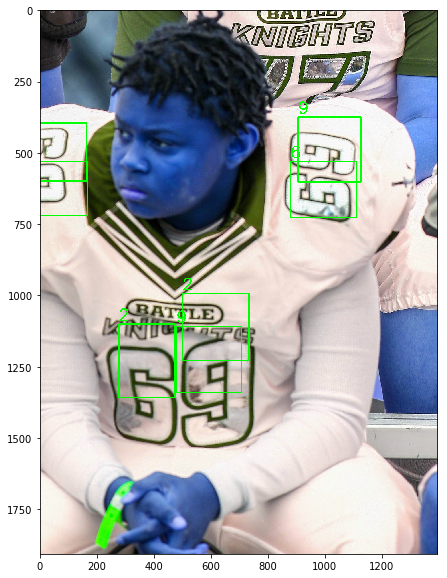

2976229
5-boxes are detected.


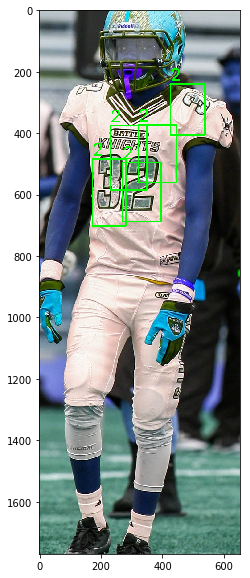

22222
6-boxes are detected.


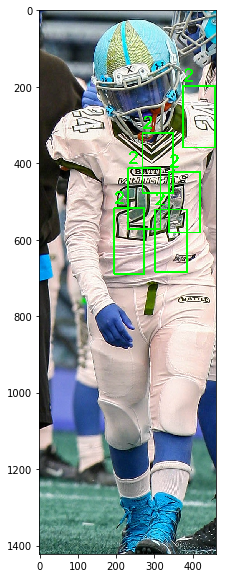

222222
0-boxes are detected.


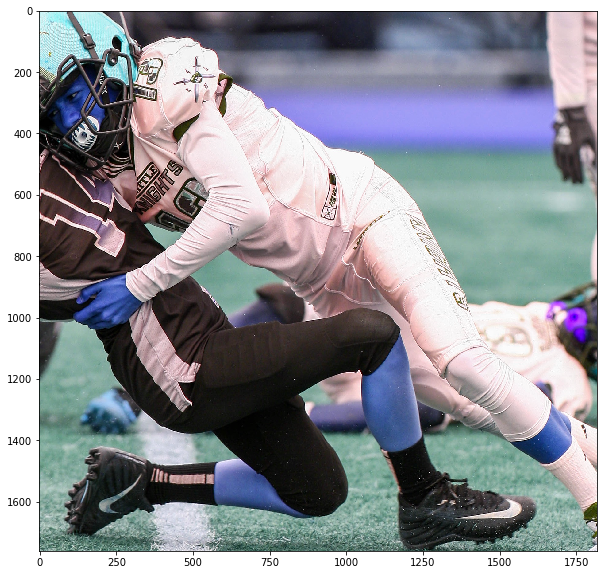


2-boxes are detected.


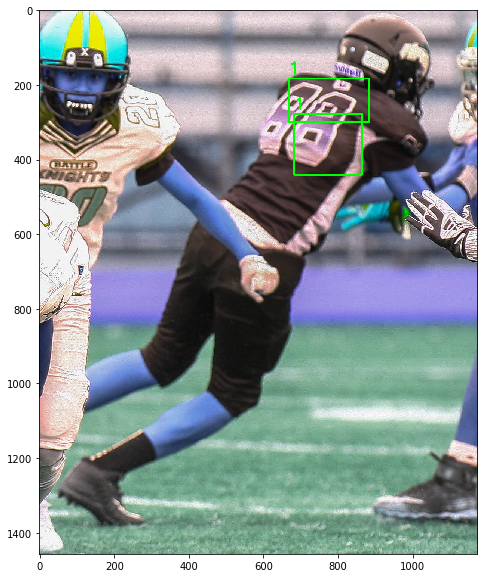

11
1-boxes are detected.


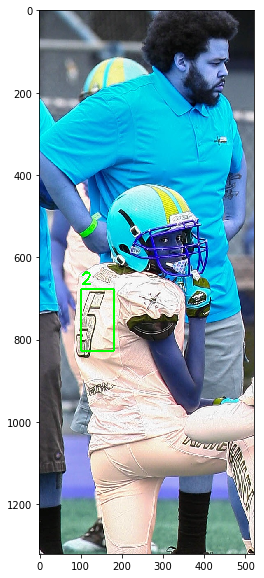

2
6-boxes are detected.


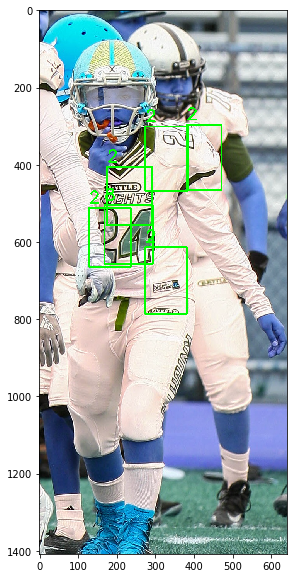

222282
3-boxes are detected.


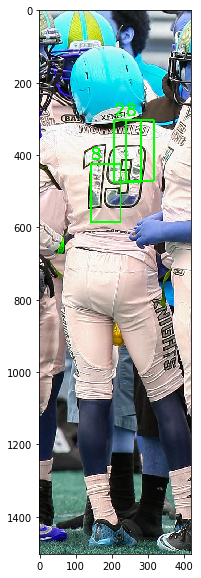

288
0-boxes are detected.


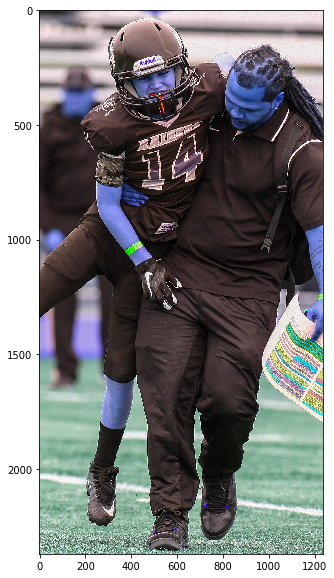

In [52]:
# 3. read image
threshold=0.1
write_dname = "trained_full_detected_on_person"
if not os.path.exists(write_dname): 
    os.makedirs(write_dname)
# img_path = "D:\\Projects\\RetrieveByJerseyNumber\\Yolo-digit-detector-master\\SYFL NATIONALS 12-14-18"
img_path = "D:\\Projects\\RetrieveByJerseyNumber\\Yolo-digit-detector-master\\New folder\\detections\\person\\unlabelled"
img_files=glob.glob(img_path+"/*.jpg")
all_boxes = []
all_probs = []
for fname in img_files:
    img = cv2.imread(fname)
    img_out=img.copy()
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    # img = cv2.resize(img,(416,416))
    h = (img.shape)[0]
    # img = img[0:round(h/2)]
    # img = cv2.resize(img,(416,416))
    boxes, probs = detector.predict(img, threshold)
#     print(boxes)
#     print(type(boxes))
#     break
    image = draw_scaled_boxes(img_out,boxes,probs,
#                               np.array([boxes[0]]),
#                               np.array([probs[0]]),
                              ["0", "1", "2", "3", "4", "5", "6", "7", "8", "9"])

    all_boxes.append(boxes)
    all_probs.append(probs)
    print("{}-boxes are detected.".format(len(boxes)))
    plt.imshow(image)
    plt.show()
    number = ''
    for p in probs:
        number+=str(np.argmax(p))
    
    print(number)
    output_path = os.path.join(write_dname, os.path.split(fname)[-1])
#     break
#     cv2.imwrite(output_path, image)


In [49]:
boxes

array([[323, 323, 430, 372],
       [327, 373, 432, 431]])

In [0]:
for i in range(len(all_boxes)):
    

In [35]:
boxes[0][0]

21